## LOADING DATA

In [ ]:
!wget --header="Host: doc-04-0c-docs.googleusercontent.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/84.0.4147.135 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9" --header="Referer: https://drive.google.com/drive/folders/13dXJZqM3nIG8ynV9hs8o49ecXZ0La6jE" --header="Cookie: AUTH_gjojhqhi4lag2uhnc0pb2jeln2u870gk_nonce=s988acggkhabg" --header="Connection: keep-alive" "https://doc-04-0c-docs.googleusercontent.com/docs/securesc/d201caojpdbt8uokhi08svtinkn1a9si/ijlua6b9cmc7cnod1di3ssdlkaia7fs7/1599404700000/00484516897554883881/13071881423479456781/1rxD15nyeIPIAZ-J2VYPrDRZI66-TBWvM?e=download&authuser=0&nonce=s988acggkhabg&user=13071881423479456781&hash=pcvk8ndvdgn25j6ms86v4p9219dgdtls" -c -O 'documents.rar'

--2020-09-06 15:06:57--  https://doc-04-0c-docs.googleusercontent.com/docs/securesc/d201caojpdbt8uokhi08svtinkn1a9si/ijlua6b9cmc7cnod1di3ssdlkaia7fs7/1599404700000/00484516897554883881/13071881423479456781/1rxD15nyeIPIAZ-J2VYPrDRZI66-TBWvM?e=download&authuser=0&nonce=s988acggkhabg&user=13071881423479456781&hash=pcvk8ndvdgn25j6ms86v4p9219dgdtls
Resolving doc-04-0c-docs.googleusercontent.com (doc-04-0c-docs.googleusercontent.com)... 74.125.195.132, 2607:f8b0:400e:c09::84
Connecting to doc-04-0c-docs.googleusercontent.com (doc-04-0c-docs.googleusercontent.com)|74.125.195.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/rar]
Saving to: ‘documents.rar’

documents.rar           [  <=>               ]  18.16M  67.8MB/s    in 0.3s    

2020-09-06 15:06:58 (67.8 MB/s) - ‘documents.rar’ saved [19038123]



In [ ]:
!pip install pyunpack
!pip install patool
from pyunpack import Archive
Archive('/content/documents.rar').extractall('/content/documents')

     |████████████████████████████████| 81kB 3.5MB/s 


## Observing DATA


In [ ]:
import os

In [ ]:
path, dirs, files = next(os.walk("/content/documents/documents"))
file_count = len(files)

In [ ]:
file_count

18828

In [ ]:
b = os.listdir("/content/documents/documents")

In [ ]:
type(b)

list

In [ ]:
b[0]

'comp.graphics_38867.txt'

### Extracting Labels

In [ ]:
labels = []
for i in range(len(b)):
  
  l = b[i].split("_")
  labels.append(l[0])


In [ ]:
print(labels)

['comp.graphics', 'comp.windows.x', 'alt.atheism', 'rec.sport.hockey', 'sci.crypt', 'alt.atheism', 'comp.windows.x', 'comp.os.ms-windows.misc', 'talk.politics.misc', 'talk.politics.guns', 'comp.os.ms-windows.misc', 'soc.religion.christian', 'talk.religion.misc', 'rec.sport.hockey', 'comp.sys.ibm.pc.hardware', 'rec.autos', 'comp.windows.x', 'sci.crypt', 'misc.forsale', 'rec.sport.baseball', 'talk.politics.misc', 'comp.sys.ibm.pc.hardware', 'sci.space', 'talk.politics.misc', 'comp.sys.ibm.pc.hardware', 'rec.autos', 'rec.autos', 'comp.sys.ibm.pc.hardware', 'misc.forsale', 'talk.politics.guns', 'sci.med', 'sci.crypt', 'comp.windows.x', 'comp.sys.ibm.pc.hardware', 'sci.crypt', 'sci.med', 'comp.sys.mac.hardware', 'comp.os.ms-windows.misc', 'comp.sys.mac.hardware', 'talk.politics.mideast', 'alt.atheism', 'talk.religion.misc', 'sci.crypt', 'rec.sport.hockey', 'sci.space', 'talk.politics.mideast', 'soc.religion.christian', 'sci.med', 'talk.politics.guns', 'soc.religion.christian', 'comp.sys.ibm

In [ ]:
len(labels)

18828

## Count of each label


In [ ]:
class1 = set(labels)
class1 =list(class1)

In [ ]:
data = {}

for i in range(len(class1)):

  data[class1[i]] = labels.count(class1[i])



data


{'alt.atheism': 799,
 'comp.graphics': 973,
 'comp.os.ms-windows.misc': 985,
 'comp.sys.ibm.pc.hardware': 982,
 'comp.sys.mac.hardware': 961,
 'comp.windows.x': 980,
 'misc.forsale': 972,
 'rec.autos': 990,
 'rec.motorcycles': 994,
 'rec.sport.baseball': 994,
 'rec.sport.hockey': 999,
 'sci.crypt': 991,
 'sci.electronics': 981,
 'sci.med': 990,
 'sci.space': 987,
 'soc.religion.christian': 997,
 'talk.politics.guns': 910,
 'talk.politics.mideast': 940,
 'talk.politics.misc': 775,
 'talk.religion.misc': 628}

In [ ]:
count_labels = list(data.values())
count_labels

[990,
 994,
 973,
 799,
 982,
 985,
 972,
 994,
 997,
 987,
 775,
 990,
 980,
 940,
 961,
 981,
 999,
 628,
 910,
 991]

## Ploting Distribution of Labels


In [ ]:
import pandas as pd 
from matplotlib import pyplot as plt 

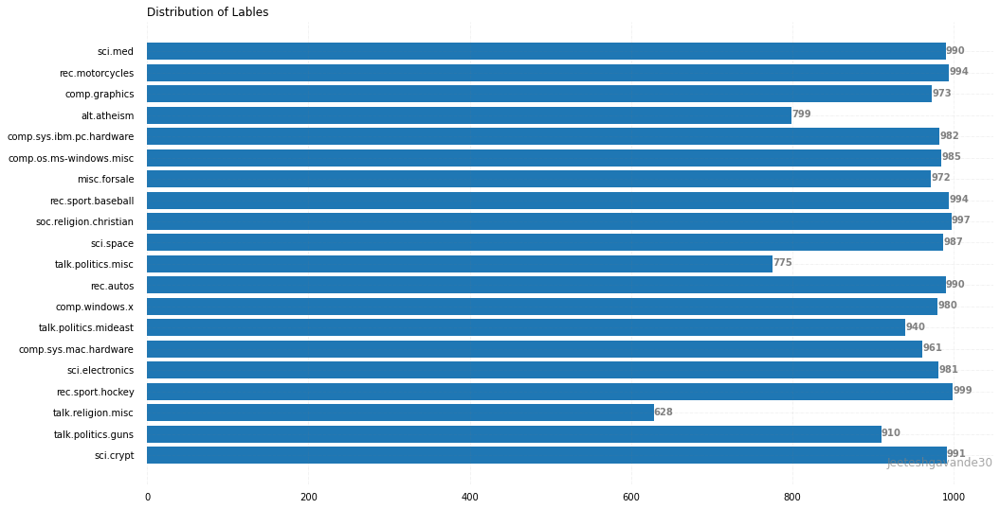

In [ ]:
fig, ax = plt.subplots(figsize =(16, 9)) 
  
# Horizontal Bar Plot 
ax.barh(class1, count_labels) 
  
# Remove axes splines 
for s in ['top', 'bottom', 'left', 'right']: 
    ax.spines[s].set_visible(False) 
  
# Remove x, y Ticks 
ax.xaxis.set_ticks_position('none') 
ax.yaxis.set_ticks_position('none') 
  
# Add padding between axes and labels 
ax.xaxis.set_tick_params(pad = 5) 
ax.yaxis.set_tick_params(pad = 10) 
  
# Add x, y gridlines 
ax.grid(b = True, color ='grey', 
        linestyle ='-.', linewidth = 0.5, 
        alpha = 0.2) 
  
# Show top values  
ax.invert_yaxis() 
  
# Add annotation to bars 
for i in ax.patches: 
    plt.text(i.get_width()+0.2, i.get_y()+0.5,  
             str(round((i.get_width()), 2)), 
             fontsize = 10, fontweight ='bold', 
             color ='grey') 
  
# Add Plot Title 
ax.set_title('Distribution of Lables', 
             loc ='left', ) 
  
# Add Text watermark 
fig.text(0.9, 0.15, 'Jeeteshgavande30', fontsize = 12, 
         color ='grey', ha ='right', va ='bottom', 
         alpha = 0.7) 
  
# Show Plot 
plt.show()

## Functions for text preprocessing

In [ ]:
import re

### EMAIL

In [ ]:
def email(text):
  
  a = text
  s =[]
  
  for i in range(len(a)):
    
    val = re.findall('@\S+', a[i])
    
    if (len(val)!=0):
      
      for j in range(len(val)):
        
        val2 = val[j].replace('@','') 
        val3 = val2.split(".")
        
        for k in range(len(val3)):
          if(len(val3[k])>2):
            s.append(val3[k])
  em = " ".join(s)
  em = em.strip()
  return em   

### Subject

In [ ]:
def subject(text):
  
  sub = []
  a = text 
  for i in range(len(a)):
    
    c = a[i].split()
    
    if (len(c)!= 0):
      
      if(c[0] == "Subject:"):
        val = a[i]
        val = val.replace('Subject:','')
        val = val.replace('Re:','')
        val = val.replace('@','')
        val = val.replace('\r','')
        val = val.replace('\n','')
        val = val.replace('\\"','')
        #val = a[i]
        val = val.replace('Subject:','')
        val = val.replace('@','')
        val = val.replace('\r','')
        val = val.replace('\n','')
        val = val.replace('\\"','')
        val = val.replace('<','')
        val = val.replace('>','')
        val = val.replace('\t','')
        val = val.replace('\n','')
        val = val.replace('-', '')
        val = val.replace('.', '')
        val = val.replace('?', '')
        val = val.replace(',', '')
        val = val.replace('"', '')
            
             
        # 6  Delete all the tags like "< anyword >"
        val = re.sub(r'\<[^)]*\>', '', val) 
    
            
        # 7  Delete all the data which are present in the brackets. 
        val = re.sub(r'\([^)]*\)', '', val)
            
            
            
        # 9  Remove all the words which ends with ":"
        s = re.findall('\S+:', val)
        for k in range(len(s)):
          val = val.replace(s[k], '')
            
            
        #10   can't -> can not, 's -> is, i've -> i have, i'm -> i am, you're -> you are, i'll --> i will 
        val = re.sub(r"won't", "will not", val)
        val = re.sub(r"can\'t", "can not", val)
        val = re.sub(r"n\'t", " not", val)
        val = re.sub(r"\'re", " are", val)
        val = re.sub(r"\'s", " is", val)
        val = re.sub(r"\'d", " would", val)
        val = re.sub(r"\'ll", " will", val)
        val = re.sub(r"\'t", " not", val)
        val = re.sub(r"\'ve", " have", val)
        val = re.sub(r"\'m", " am", val)
        sub.append(val)

  subj = " ".join(sub)
  subj = subj.strip()
  return subj 

      

## Preprocessing Part 1

In [ ]:
def listToString(s):  
    
    # initialize an empty string 
    str1 = ""  
    
    # traverse in the string   
    for ele in s:
      
      if(len(ele) != 0):
        ele = ele.strip()
        str1 += ele 
        str1 = str1 + " "
    
    # return string 
    str1 = str1.strip()
    return str1  

In [ ]:
def preprocess_1(text):

  
  a = text 
  
  for i in range(len(a)):
    
    # 1 REMOVING EMAIL FROM ORIGNAL TEXT
    val = re.findall('\S+@\S+', a[i])
    
    if (len(val)!=0):
      
      for j in range(len(val)):
        
        a[i] = a[i].replace(val[j],'') 
    
    
    c = a[i].split()
    
    #3 REMOVING SUBJECT FROM ORIGNAL TEXT
    if(len(c)!= 0):
      
      if (c[0] == "Subject:"):
        
        a[i] = a[i].replace('Subject:','')
        a[i] = a[i].replace('@','')
        a[i] = a[i].replace('\r','')
        a[i] = a[i].replace('\n','')
        a[i] = a[i].replace('\\','')
    
    #5 REMOVING "Write to:" or "From:" ORIGNAL TEXT
        
      if (c[0] == "From:" or c[0] == "Write to:"):
        a[i] = a[i].replace(a[i],'')
            
        
      else:
        # 8  Remove all the newlines('\n'), tabs('\t'), "-", "\".
        
        a[i] = a[i]
        a[i] = a[i].replace('Subject:','')
        a[i] = a[i].replace('@','')
        a[i] = a[i].replace('\r','')
        a[i] = a[i].replace('\n','')
        a[i] = a[i].replace('\\"','')
        a[i] = a[i].replace('<','')
        a[i] = a[i].replace('>','')
        a[i] = a[i].replace('\t','')
        a[i] = a[i].replace('\n','')
        a[i] = a[i].replace('-', '')
        a[i] = a[i].replace('.', '')
        a[i] = a[i].replace('?', '')
        a[i] = a[i].replace(',', '')
        a[i] = a[i].replace('"', '')
            
            
        # 6  Delete all the tags like "< anyword >"
        a[i] = re.sub(r'\<[^)]*\>', '', a[i]) 
    
            
        # 7  Delete all the data which are present in the brackets. 
        a[i] = re.sub(r'\([^)]*\)', '', a[i])
            
            
            
        # 9  Remove all the words which ends with ":"
        s = re.findall('\S+:', a[i])
        for k in range(len(s)):
          a[i] = a[i].replace(s[k], '')
            
            
        #10   can't -> can not, 's -> is, i've -> i have, i'm -> i am, you're -> you are, i'll --> i will 
        a[i] = re.sub(r"won't", "will not", a[i])
        a[i] = re.sub(r"can\'t", "can not", a[i])
        a[i] = re.sub(r"n\'t", " not", a[i])
        a[i] = re.sub(r"\'re", " are", a[i])
        a[i] = re.sub(r"\'s", " is", a[i])
        a[i] = re.sub(r"\'d", " would", a[i])
        a[i] = re.sub(r"\'ll", " will", a[i])
        a[i] = re.sub(r"\'t", " not", a[i])
        a[i] = re.sub(r"\'ve", " have", a[i])
        a[i] = re.sub(r"\'m", " am", a[i])
  
  se= listToString(a)
  return se        

In [ ]:
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

### Chunkimg

In [ ]:
 import nltk 
 nltk.download('punkt')
 nltk.download('maxent_ne_chunker')
 nltk.download('words')
 nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package maxent_ne_chunker to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping chunkers/maxent_ne_chunker.zip.
[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [ ]:
from nltk import ne_chunk, pos_tag, word_tokenize
from nltk.tree import Tree

In [ ]:
def find_GPE_AND_PERSON(sent):

  tree = ne_chunk(pos_tag(word_tokenize(sent)))
  
  GPE = []
  PERSON = []
  
  for i in tree:
    
    b=list(i)
    
    if type(i) == Tree:
      
      c = i.label()
      
      if (c=='GPE'):
        
        for j in range(len(b)):
          GPE.append(b[j][0])

      if (c=='PERSON'):
        
        for k in range(len(b)):
          PERSON.append(b[k][0])


  
  
  return (GPE ,PERSON)


In [ ]:
def joinGPE(sent):
  x1 = ""

  for i in range(len(sent)):
    x = sent[i]
    #x1 =""

    if (i<len(sent)-1):

      x1 = x1 + x + "_"

    else:

       x1 = x1 + x


  return x1

In [ ]:
def chunk_text(sent,text):

  sent = find_GPE_AND_PERSON(text)
  join = " "



  text1  =text.split()

  if (len(sent[0]) != 0):
    
    GPE = sent[0]
    #PERSON = sent[1]
    join = joinGPE(sent[0])
    
    for i in range(len(GPE)):
      
      text = text.replace(GPE[i],'')

  if (len(sent[1]) != 0):
    
    #GPE = sent[0]
    PERSON = sent[1]
    #join = joinGPE(sent[0])
    
    for i in range(len(PERSON)):
      
      text = text.replace(PERSON[i],'')
      
  text = text +" " + join
  #text = text.replace(" ","")

  text = " ".join(text.split())
  return text

### Final Preprocessing

In [ ]:
def final_text(text):

  #chunking
  
  sen = find_GPE_AND_PERSON(text)
  
  sen1 = joinGPE(sen[0])
  
  text = chunk_text(sen,text)





  # Remove digits
  text = re.sub("\d+", "", text)

  #Removing Underscore part1 and part2
  text1 = text.split()
  
  for i in range(len(text1)):
    
    c =text1[i]
    l = len(c)



    if(c[0]=="_" and c[l-1]=="_"):
      text1[i] = text1[i].replace("_","")
      
    if(c[0]=="_"):
      text1[i] = text1[i].replace("_","")
    
    if(c[l-1]=="_"):
       text1[i] = text1[i].replace("_","")

    a1 = text1[i]
    a2 = a1.split("_")
    
    if(len(a2)==2):
      
      if(len(a2[0])<= 2):
        text1[i] = a2[1]

    #Checking Word length
    if(len(text1[i])>=15 or len(text1[i])<=2):
      text1[i] = text1[i].replace(text1[i],"")

  
  text2 = " ".join(text1)

  text = text2.strip()

  #Converting Lower Case
  text = text.lower()


  
  return text

# Text Classification:

## Data
<pre>
1. we have total of 20 types of documents(Text files) and total 18828 documents(text files).
2. You can download data from this <a href='https://drive.google.com/open?id=1rxD15nyeIPIAZ-J2VYPrDRZI66-TBWvM'>link</a>, in that you will get documents.rar folder. <br>If you unzip that, you will get total of 18828 documnets. document name is defined as'ClassLabel_DocumentNumberInThatLabel'. 
so from document name, you can extract the label for that document.
4. Now our problem is to classify all the documents into any one of the class.
5. Below we provided count plot of all the labels in our data. 
</pre>

In [ ]:
### count plot of all the class labels. 

## Assignment:

#### sample document
<pre>
<font color='blue'>
Subject: A word of advice
From: jcopelan@nyx.cs.du.edu (The One and Only)

In article < 65882@mimsy.umd.edu > mangoe@cs.umd.edu (Charley Wingate) writes:
>
>I've said 100 times that there is no "alternative" that should think you
>might have caught on by now.  And there is no "alternative", but the point
>is, "rationality" isn't an alternative either.  The problems of metaphysical
>and religious knowledge are unsolvable-- or I should say, humans cannot
>solve them.

How does that saying go: Those who say it can't be done shouldn't interrupt
those who are doing it.

Jim
--
Have you washed your brain today?
</font>
</pre>

### Preprocessing:
<pre>
useful links: <a href='http://www.pyregex.com/'>http://www.pyregex.com/</a>

<font color='blue'><b>1.</b></font> Find all emails in the document and then get the text after the "@". and then split those texts by '.' 
after that remove the words whose length is less than or equal to 2 and also remove'com' word and then combine those words by space. 
In one doc, if we have 2 or more mails, get all.
<b>Eg:[test@dm1.d.com, test2@dm2.dm3.com]-->[dm1.d.com, dm3.dm4.com]-->[dm1,d,com,dm2,dm3,com]-->[dm1,dm2,dm3]-->"dm1 dm2 dm3" </b> 
append all those into one list/array. ( This will give length of 18828 sentences i.e one list for each of the document). 
Some sample output was shown below. 

> In the above sample document there are emails [jcopelan@nyx.cs.du.edu, 65882@mimsy.umd.edu, mangoe@cs.umd.edu]

preprocessing:
[jcopelan@nyx.cs.du.edu, 65882@mimsy.umd.edu, mangoe@cs.umd.edu] ==> [nyx cs du edu mimsy umd edu cs umd edu] ==> 
[nyx edu mimsy umd edu umd edu]

<font color='blue'><b>2.</b></font> Replace all the emails by space in the original text. 
</pre>

<pre>
<font color='blue'><b>3.</b></font> Get subject of the text i.e. get the total lines where "Subject:" occur and remove 
the word which are before the ":" remove the newlines, tabs, punctuations, any special chars.
<b>Eg: if we have sentance like "Subject: Re: Gospel Dating @ \r\r\n" --> You have to get "Gospel Dating"</b> 
Save all this data into another list/array. 

<font color='blue'><b>4.</b></font> After you store it in the list, Replace those sentances in original text by space.

<font color='blue'><b>5.</b></font> Delete all the sentances where sentence starts with <b>"Write to:"</b> or <b>"From:"</b>.
> In the above sample document check the 2nd line, we should remove that

<font color='blue'><b>6.</b></font> Delete all the tags like "< anyword >"
> In the above sample document check the 4nd line, we should remove that "< 65882@mimsy.umd.edu >"


<font color='blue'><b>7.</b></font> Delete all the data which are present in the brackets. 
In many text data, we observed that, they maintained the explanation of sentence 
or translation of sentence to another language in brackets so remove all those.
<b>Eg: "AAIC-The course that gets you HIRED(AAIC - Der Kurs, der Sie anstellt)" --> "AAIC-The course that gets you HIRED"</b>

> In the above sample document check the 4nd line, we should remove that "(Charley Wingate)"


<font color='blue'><b>8.</b></font> Remove all the newlines('\n'), tabs('\t'), "-", "\".

<font color='blue'><b>9.</b></font> Remove all the words which ends with <b>":"</b>.
<b>Eg: "Anyword:"</b>
> In the above sample document check the 4nd line, we should remove that "writes:"


<font color='blue'><b>10.</b></font> Decontractions, replace words like below to full words. 
please check the donors choose preprocessing for this 
<b>Eg: can't -> can not, 's -> is, i've -> i have, i'm -> i am, you're -> you are, i'll --> i will </b>

<b> There is no order to do point 6 to 10. but you have to get final output correctly</b>

<font color='blue'><b>11.</b></font> Do chunking on the text you have after above preprocessing. 
Text chunking, also referred to as shallow parsing, is a task that 
follows Part-Of-Speech Tagging and that adds more structure to the sentence.
So it combines the some phrases, named entities into single word.
So after that combine all those phrases/named entities by separating <b>"_"</b>. 
And remove the phrases/named entities if that is a "Person". 
You can use <b>nltk.ne_chunk</b> to get these. 
Below we have given one example. please go through it. 

useful links: 
<a href='https://www.nltk.org/book/ch07.html'>https://www.nltk.org/book/ch07.html</a>
<a href='https://stackoverflow.com/a/31837224/4084039'>https://stackoverflow.com/a/31837224/4084039</a>
<a href='http://www.nltk.org/howto/tree.html'>http://www.nltk.org/howto/tree.html</a>
<a href='https://stackoverflow.com/a/44294377/4084039'>https://stackoverflow.com/a/44294377/4084039</a>
</pre>

<pre>We did chunking for above two lines and then We got one list where each word is mapped to a 
POS(parts of speech) and also if you see "New York" and "Srikanth Varma", 
they got combined and represented as a tree and "New York" was referred as "GPE" and "Srikanth Varma" was referred as "PERSON". 
so now you have to Combine the "New York" with <b>"_"</b> i.e "New_York"
and remove the "Srikanth Varma" from the above sentence because it is a person.</pre>

<pre>
<font color='blue'><b>13.</b></font> Replace all the digits with space i.e delete all the digits. 
> In the above sample document, the 6th line have digit 100, so we have to remove that.

<font color='blue'><b>14.</b></font> After doing above points, we observed there might be few word's like
 <b> "_word_" (i.e starting and ending with the _), "_word" (i.e starting with the _),
  "word_" (i.e ending with the _)</b> remove the <b>_</b> from these type of words. 

<font color='blue'><b>15.</b></font>  We also observed some words like <b> "OneLetter_word"- eg: d_berlin, 
"TwoLetters_word" - eg: dr_berlin </b>, in these words we remove the "OneLetter_" (d_berlin ==> berlin) and 
"TwoLetters_" (de_berlin ==> berlin). i.e remove the words 
which are length less than or equal to 2 after spliiting those words by "_". 

<font color='blue'><b>16.</b></font> Convert all the words into lower case and lowe case 
and remove the words which are greater than or equal to 15 or less than or equal to 2.

<font color='blue'><b>17.</b></font> replace all the words except "A-Za-z_" with space. 

<font color='blue'><b>18.</b></font> Now You got Preprocessed Text, email, subject. create a dataframe with those. 
Below are the columns of the df. 
</pre>

## Computing above steps 

In [ ]:
def preprocess(document):


  #EMAIL
  sent =email(document)
  sent = sent.split()
  
  for i in range(len(sent)):
    
    sent[i] = re.sub(r'[^a-zA-Z_]+','',sent[i])
  
  pe = " ".join(sent)
  pe = pe.lower().strip()
  preproessed_emails = pe

  
  #SUBJECT
  sent =subject(document)
  sent = sent.split()
  
  for i in range(len(sent)):
    sent[i] = re.sub(r'[^a-zA-Z_]+','',sent[i])
    
  subj = " ".join(sent)
  subj = subj.lower().strip()
  preproessed_subject = subj



  #TEXT
  p1 = preprocess_1(document)
  #print(p1)
  #p1 = str(p1)
  #print(type(p1))
  sent = final_text(preprocess_1(document))
  sent = sent.split()
  
  for i in range(len(sent)):
    sent[i] = re.sub(r'[^a-zA-Z_]+','',sent[i])
    
  final = " ".join(e for e in sent if e.lower() not in stopwords)
  final = final.lower().strip()
  preproessed_text = final

  return (preproessed_emails,preproessed_subject,preproessed_text)

In [ ]:
b = os.listdir("/content/documents/documents")

from tqdm import tqdm

final_email = []

final_subject = []

final_text1 = []

labels = []

for i in tqdm(range(len(b))):



  fa=[]
  fb=[]
  fc=[]

  
  with open('/content/documents/documents/{0}'.format(b[i]), encoding="utf8", errors='ignore') as f:
    
    a1 = []
    
    for x in f:
      
      line=x.rstrip()
      a1.append(line)
  
  l = b[i].split("_")
  labels.append(l[0])
  
  out = preprocess(a1)

  fa.append(out[0])
  final_email.append(fa)

  fb.append(out[1])
  final_subject.append(fb)

  fc.append(out[2])
  final_text1.append(fc)
  



100%|██████████| 18828/18828 [38:33<00:00,  8.14it/s]


In [ ]:
#labels

In [ ]:
len(final_email)

18828

In [ ]:
len(final_subject)

18828

In [ ]:
len(final_text1)

18828

In [ ]:
final_email1 = []
final_subject1=[]
final_text2 = []

for i in tqdm(range(len(final_email))):

  final_email1. append(final_email[i][0])
  final_subject1. append(final_subject[i][0])
  final_text2. append(final_text1[i][0])

100%|██████████| 18828/18828 [00:00<00:00, 578317.09it/s]


## Creating Dataframe

In [ ]:
import pandas as pd

cars = {'Prepocess_email': final_email1,'Prepocess_subject': final_subject1,'Prepocess_text': final_text2
        }

df = pd.DataFrame(cars, columns = ['Prepocess_email','Prepocess_subject','Prepocess_text'])
df

,Prepocess_email,Prepocess_subject,Prepocess_text
0,altair csustan edu nps navy mil,acm siggraph registration problem,acm siggraph registration problem word warning...
1,irs inf tudresden irs inf tudresden,xdm backgroundpixmap,xdm background tried get rid xdm ugly window g...
2,pooh bears aurora engr latech edu engr latech ...,faith and dogma,article dogma dangerous dogma inevitable chris...
3,ramsey laurentian sfu ca fraser sfu cam org ra...,canadiens another stanley cup,canadiens another stanley cup kind team take c...
4,access digex com,is key escrow enough,key escrow enough points raised checking actua...
...,...,...,...
18823,monash edu,where did the hacker ethic go,hacker ethic cheerful note perhaps not complet...
18824,novell com oasun oracle com oracle com novell com,how to act in front of traffic jerks,act front traffic jerks article unless cager p...
18825,albnyvms bitnet,buying a used car,buying used car questions tax used car purchas...
18826,adobe com,honda accord brake problem,writes hit magic mile mark sorts things beginn...


In [ ]:
import pandas as pd

cars = {'labels': labels}

df1 = pd.DataFrame(cars, columns = ['labels'])

df1


,labels
0,comp.graphics
1,comp.windows.x
2,alt.atheism
3,rec.sport.hockey
4,sci.crypt
...,...
18823,comp.graphics
18824,rec.motorcycles
18825,rec.autos
18826,rec.autos


In [ ]:
df.columns

Index(['Prepocess_email', 'Prepocess_subject', 'Prepocess_text'], dtype='object')

In [ ]:
df.iloc[400]

Prepocess_email                              eos ncsu edu eos ncsu edu
Prepocess_subject                                    nc capsisles fans
Prepocess_text       capsisles fans capsisles fans anyone intereste...
Name: 400, dtype: object

### As it takes time to compute preprocessing of all document hence we are saving dataframe in CSV

In [ ]:
df.to_csv('file1.csv') 

In [ ]:
df1.to_csv('file2.csv')

### To get above mentioned data frame --> Try to Write Total Preprocessing steps in One Function Named Preprocess as below. 

In [ ]:
def preprocess(document):


  #EMAIL
  sent =email(document)
  sent = sent.split()
  
  for i in range(len(sent)):
    
    sent[i] = re.sub(r'[^a-zA-Z_]+','',sent[i])
  
  pe = " ".join(sent)
  pe = pe.lower().strip()
  preproessed_emails = pe

  
  #SUBJECT
  sent =subject(document)
  sent = sent.split()
  
  for i in range(len(sent)):
    sent[i] = re.sub(r'[^a-zA-Z_]+','',sent[i])
    
  subj = " ".join(sent)
  subj = subj.lower().strip()
  preproessed_subject = subj



  #TEXT
  p1 = preprocess_1(document)
  #print(p1)
  #p1 = str(p1)
  #print(type(p1))
  sent = final_text(preprocess_1(document))
  sent = sent.split()
  
  for i in range(len(sent)):
    sent[i] = re.sub(r'[^a-zA-Z_]+','',sent[i])
    
  final = " ".join(e for e in sent if e.lower() not in stopwords)
  final = final.lower().strip()
  preproessed_text = final

  return (preproessed_emails,preproessed_subject,preproessed_text)

### Code checking:

<font color='red' size=4>
After Writing preprocess function. call that functoin with the input text of 'alt.atheism_49960' doc and print the output of the preprocess function
<br>
This will help us to evaluate faster, based on the output we can suggest you if there are any changes.
</font>

In [ ]:
with open("/content/alt.atheism_49960.txt", encoding="utf8", errors='ignore') as f:
  
  a1 = []
  for x in f:
    line=x.rstrip()
    a1.append(line)

In [ ]:
out = preprocess(a1)

#### EMAIL

In [ ]:
out[0]

'mantis uk netcom com mantis'

#### Subject


In [ ]:
out[1]

'altatheism atheist resources'

#### Text

In [ ]:
out[2]

'alt resources december addresses organizations usa freedom religion foundation fish bumper stickers assorted atheist paraphernalia available freedom religion foundation write ffrf box madison evolution designs evolution designs sell fish fish symbol like ones stick cars feet word written inside deluxe moulded plastic fish postpaid write evolution designs hollywood people san francisco bay area get try mailing net people directly price per fish american atheist press aap publish various atheist books critiques bible lists contradictions one book bible handbook ball foote press isbn edition bible contradictions absurdities atrocities immoralities contains ball bible contradicts aap based ing version bible write press box prometheus boos sell books including write amherst street alternate address humanism organization promoting black secular humanism uncovering history black freethought publish quarterly newsletter aah examiner write norm allen african humanism box press association nati

### After writing Preprocess function, call the function for each of the document(18828 docs) and then create a dataframe as mentioned above.

### Training The models to Classify: 

<pre>
1. Combine "preprocessed_text", "preprocessed_subject", "preprocessed_emails" into one column. use that column to model. 

2. Now Split the data into Train and test. use 25% for test also do a stratify split. 

3. Analyze your text data and pad the sequnce if required. 
Sequnce length is not restricted, you can use anything of your choice. 
you need to give the reasoning

4. Do Tokenizer i.e convert text into numbers. please be careful while doing it. 
if you are using tf.keras "Tokenizer" API, it removes the <b>"_"</b>, but we need that.

5. code the model's ( Model-1, Model-2 ) as discussed below 
and try to optimize that models.  

6. For every model use predefined Glove vectors. 
<b>Don't train any word vectors while Training the model.</b>

7. Use "categorical_crossentropy" as Loss. 

8. Use <b>Accuracy and Micro Avgeraged F1 score</b> as your as Key metrics to evaluate your model. 

9.  Use Tensorboard to plot the loss and Metrics based on the epoches.

10. Please save your best model weights in to <b>'best_model_L.h5' ( L = 1 or 2 )</b>. 

11. You are free to choose any Activation function, learning rate, optimizer.
But have to use the same architecture which we are giving below.

12. You can add some layer to our architecture but you <b>deletion</b> of layer is not acceptable.

13. Try to use <b>Early Stopping</b> technique or any of the callback techniques that you did in the previous assignments.

14. For Every model save your model to image ( Plot the model) with shapes 
and inlcude those images in the notebook markdown cell, 
upload those imgages to Classroom. You can use "plot_model" 
please refer <a href='https://www.tensorflow.org/api_docs/python/tf/keras/utils/plot_model'>this</a> if you don't know how to plot the model with shapes. 

</pre>

In [ ]:
!wget --header="Host: doc-0k-3o-docs.googleusercontent.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/84.0.4147.135 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9" --header="Referer: https://drive.google.com/drive/u/0/my-drive" --header="Cookie: AUTH_gjojhqhi4lag2uhnc0pb2jeln2u870gk_nonce=qaru1bm36n8i8" --header="Connection: keep-alive" "https://doc-0k-3o-docs.googleusercontent.com/docs/securesc/d201caojpdbt8uokhi08svtinkn1a9si/dsf1pdup9pe85ltnot4qumv3p67qc6il/1599719775000/13071881423479456781/13071881423479456781/1kWuXm3cJIr89x7e4NkHIJizzmPS5fztD?e=download&authuser=0&nonce=qaru1bm36n8i8&user=13071881423479456781&hash=7t1m9cv1f06f4sudg0e98atqitjq8mid" -c -O 'file1.csv'

--2020-09-10 06:37:48--  https://doc-0k-3o-docs.googleusercontent.com/docs/securesc/d201caojpdbt8uokhi08svtinkn1a9si/dsf1pdup9pe85ltnot4qumv3p67qc6il/1599719775000/13071881423479456781/13071881423479456781/1kWuXm3cJIr89x7e4NkHIJizzmPS5fztD?e=download&authuser=0&nonce=qaru1bm36n8i8&user=13071881423479456781&hash=7t1m9cv1f06f4sudg0e98atqitjq8mid
Resolving doc-0k-3o-docs.googleusercontent.com (doc-0k-3o-docs.googleusercontent.com)... 64.233.189.132, 2404:6800:4008:c07::84
Connecting to doc-0k-3o-docs.googleusercontent.com (doc-0k-3o-docs.googleusercontent.com)|64.233.189.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘file1.csv’

file1.csv               [ <=>                ]  15.93M  89.0MB/s    in 0.2s    

2020-09-10 06:37:49 (89.0 MB/s) - ‘file1.csv’ saved [16703156]



In [ ]:
import pandas as pd
df = pd.read_csv('/content/file1.csv')
df = df.drop(['Unnamed: 0'], axis=1)
df

,Prepocess_email,Prepocess_subject,Prepocess_text
0,altair csustan edu nps navy mil,acm siggraph registration problem,acm siggraph registration problem word warning...
1,irs inf tudresden irs inf tudresden,xdm backgroundpixmap,xdm background tried get rid xdm ugly window g...
2,pooh bears aurora engr latech edu engr latech ...,faith and dogma,article dogma dangerous dogma inevitable chris...
3,ramsey laurentian sfu ca fraser sfu cam org ra...,canadiens another stanley cup,canadiens another stanley cup kind team take c...
4,access digex com,is key escrow enough,key escrow enough points raised checking actua...
...,...,...,...
18823,monash edu,where did the hacker ethic go,hacker ethic cheerful note perhaps not complet...
18824,novell com oasun oracle com oracle com novell com,how to act in front of traffic jerks,act front traffic jerks article unless cager p...
18825,albnyvms bitnet,buying a used car,buying used car questions tax used car purchas...
18826,adobe com,honda accord brake problem,writes hit magic mile mark sorts things beginn...


In [ ]:
import pandas as pd
df1 = pd.read_csv('/content/file2.csv')
df1 = df1.drop(['Unnamed: 0'], axis=1)
df1

,labels
0,comp.graphics
1,comp.windows.x
2,alt.atheism
3,rec.sport.hockey
4,sci.crypt
...,...
18823,comp.graphics
18824,rec.motorcycles
18825,rec.autos
18826,rec.autos


## 1

In [ ]:
df=df.applymap(str)

In [ ]:
df1=df1.applymap(str)

In [ ]:
df['Prepocess_email'].isnull().values.any()

False

In [ ]:
df['Prepocess_subject'].isnull().values.any()

False

In [ ]:
df['Prepocess_text'].isnull().values.any()

False

In [ ]:
che= df

combine = che['Prepocess_email'] + " " + che["Prepocess_subject"] + " "+ che["Prepocess_text"]

In [ ]:
df.iloc[2000]

Prepocess_email                                          rnode hub org
Prepocess_subject                        clinton press conference part
Prepocess_text       press conference part press release white hous...
Name: 2000, dtype: object

In [ ]:
combine.iloc[2000]

'rnode hub org clinton press conference part press conference part press release white house president remarks national desk white house office press secretary washington april following remarks president question answer session edt february four federal agents killed line duty trying enforce law branch ian compound illegally stockpiled weaponry ammunition placed innocent children risk batf operation failed meet objective day standoff ensued federal bureau investigation made every reasonable effort bring perilous situation end without bloodshed loss life bureau efforts ultimately unavailing individual dealing dangerous irrational probably insane engaged numerous activities violated federal law common standards decency moreover responsible deaths injuries occurred action compound february given inclination towards violence effort protect young hostages provocative actions taken seven weeks federal agents compound weekend briefed operation prepared fbi designed increase pressure persuade

In [ ]:
combine.isnull().values.any()

False

## 2

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(combine, df1, test_size=0.25, stratify=df1)

In [ ]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)


(14121,) (14121, 1)
(4707,) (4707, 1)


In [ ]:
X_train

5593     ecs umass edu engr washington edu lanmola engr...
18678    oasys navy mil phantom gatech edu nissan nomen...
15603    ncube com ncube com photo shop scanner shop sc...
18296    silver ucs indiana edu geneva rutgers edu uiuc...
3427     swarthmore edu swarthmore edu lab ntt jp nttco...
                               ...                        
1708     houston geoquest slb com spool edu studsys msc...
13268    spva rosie edu rosie edu motorola xcrc and rc ...
16134    mals gatech edu midway uchicago edu kimbark uc...
6367     marantz corp sun com attmail com mac ii scsi  ...
14397    trentu hasler ascom ch hslrswi hasler ascom bo...
Length: 14121, dtype: object

In [ ]:
y_train

,labels
5593,rec.autos
18678,rec.autos
15603,comp.sys.mac.hardware
18296,soc.religion.christian
3427,rec.sport.baseball
...,...
1708,rec.autos
13268,sci.electronics
16134,talk.politics.guns
6367,comp.sys.mac.hardware


## 3 and 4

### TOKENIZATION


#### X_train

In [ ]:
import tensorflow as tf

In [ ]:
#from keras.preprocessing.text import Tokenizer

t =tf.keras.preprocessing.text.Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\\]^`{|}~\t\n', lower=False)


# fit the tokenizer on the documents
t.fit_on_texts(X_train)
#t.texts_to_sequences(s)

In [ ]:
print(t.word_counts)

OrderedDict([('ecs', 59), ('umass', 63), ('edu', 20859), ('engr', 146), ('washington', 458), ('lanmola', 14), ('uwm', 61), ('csd', 193), ('ultimate', 88), ('awd', 28), ('vehicles', 123), ('article', 8543), ('subarus', 8), ('not', 40643), ('sell', 579), ('well', 3743), ('although', 676), ('percentage', 191), ('purchased', 146), ('probably', 1543), ('relatively', 163), ('high', 1112), ('sold', 277), ('wdawd', 1), ('audi', 12), ('backing', 71), ('number', 2005), ('models', 243), ('offers', 240), ('one', 10397), ('could', 4793), ('purchase', 241), ('reserved', 58), ('strictly', 73), ('top', 635), ('line', 1307), ('model', 510), ('goes', 643), ('eliminated', 36), ('lineup', 56), ('still', 2421), ('available', 1764), ('quattro', 14), ('version', 1112), ('though', 1386), ('hardly', 169), ('cheap', 442), ('true', 1538), ('pledge', 14), ('making', 796), ('option', 274), ('entire', 421), ('cars', 506), ('bring', 374), ('wagon', 45), ('eliot', 23), ('became', 251), ('called', 1298), ('turbo', 94)

In [ ]:
print(t.document_count)

14121


In [ ]:
print(t.word_index)

{'not': 1, 'edu': 2, 'would': 3, 'com': 4, 'one': 5, 'article': 6, 'people': 7, 'like': 8, 'know': 9, 'get': 10, 'think': 11, 'also': 12, 'could': 13, 'use': 14, 'time': 15, 'good': 16, 'even': 17, 'well': 18, 'may': 19, 'way': 20, 'much': 21, 'make': 22, 'many': 23, 'see': 24, 'two': 25, 'first': 26, 'new': 27, 'say': 28, 'right': 29, 'want': 30, 'need': 31, 'anyone': 32, 'used': 33, 'system': 34, 'said': 35, 'problem': 36, 'work': 37, 'really': 38, 'something': 39, 'since': 40, 'believe': 41, 'back': 42, 'going': 43, 'help': 44, 'still': 45, 'find': 46, 'take': 47, 'please': 48, 'using': 49, 'question': 50, 'years': 51, 'might': 52, 'point': 53, 'last': 54, 'government': 55, 'year': 56, 'must': 57, 'better': 58, 'information': 59, 'things': 60, 'bit': 61, 'never': 62, 'another': 63, 'without': 64, 'file': 65, 'sure': 66, 'read': 67, 'number': 68, 'world': 69, 'made': 70, 'drive': 71, 'someone': 72, 'got': 73, 'program': 74, 'part': 75, 'let': 76, 'thing': 77, 'come': 78, 'available':

In [ ]:
print(t.word_docs)

defaultdict(<class 'int'>, {'cars': 298, 'hardly': 165, 'ecs': 44, 'percentage': 148, 'one': 5211, 'pledge': 12, 'csd': 108, 'awd': 11, 'number': 1139, 'umass': 33, 'audi': 10, 'offers': 151, 'sell': 435, 'washington': 313, 'eliminated': 36, 'still': 1791, 'quick': 232, 'also': 3155, 'probably': 1219, 'lineup': 48, 'rare': 97, 'wdawd': 1, 'wagon': 24, 'top': 464, 'models': 157, 'became': 188, 'reserved': 44, 'goes': 550, 'available': 945, 'turbo': 60, 'high': 803, 'not': 9956, 'lanmola': 14, 'ultimate': 71, 'engr': 100, 'purchased': 121, 'model': 337, 'purchase': 182, 'sold': 210, 'although': 545, 'uwm': 35, 'version': 552, 'bring': 310, 'making': 662, 'subarus': 6, 'option': 203, 'edu': 8975, 'quattro': 8, 'vehicles': 95, 'true': 1029, 'cheap': 307, 'come': 1285, 'entire': 355, 'article': 6285, 'though': 1130, 'called': 930, 'line': 832, 'relatively': 154, 'could': 3093, 'backing': 53, 'well': 2538, 'strictly': 70, 'eliot': 23, 'nomenclature': 6, 'kind': 888, 'recautos': 26, 'uses': 4

##### y_train and  y_test one hot encoding

In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
import numpy as np

In [ ]:
te = y_train['labels']

te = te.to_numpy()

te.reshape(-1,1)

array([['rec.autos'],
       ['rec.autos'],
       ['comp.sys.mac.hardware'],
       ...,
       ['talk.politics.guns'],
       ['comp.sys.mac.hardware'],
       ['rec.autos']], dtype=object)

In [ ]:
from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder()

y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

y_train_ohe = encoder.fit_transform(y_train.reshape(-1,1))
y_test_ohe = encoder.transform(y_test.reshape(-1,1))

y_train_ohe = y_train_ohe.toarray()
y_test_ohe = y_test_ohe.toarray()

In [ ]:
len(y_train_ohe)

14121

In [ ]:
len(y_test_ohe)

4707

In [ ]:
y_train_ohe.shape

(14121, 20)

In [ ]:
y_test_ohe.shape

(4707, 20)

#### Padding

##### As we can see dimention is not same  we have to pad in such a manner so that information should not lost i am taking padding arround average of features


In [ ]:
# I am choosing 3000 as padding  because  there are very large length which lead us curse of dimentionallity

max_length = 3000

docs = t.texts_to_sequences(X_train)

padded_docs_train = pad_sequences(docs, maxlen=max_length, padding='post')

In [ ]:
# I am choosing 3000 as padding  because  there are very large length which laed us curse of dimentionallity

max_length = 3000

docs = t.texts_to_sequences(X_test)

padded_docs_test = pad_sequences(docs, maxlen=max_length, padding='post')

In [ ]:
len(docs)

4707

In [ ]:
padded_docs_train

array([[ 4446,  4216,     2, ...,     0,     0,     0],
       [ 3928,  1131,   845, ...,     0,     0,     0],
       [14646,     4, 14646, ...,     0,     0,     0],
       ...,
       [92759,  1052,     2, ...,     0,     0,     0],
       [92763,  1501,   217, ...,     0,     0,     0],
       [13026,  9991, 10308, ...,     0,     0,     0]], dtype=int32)

In [ ]:
padded_docs_test

array([[3307, 1501, 1082, ...,    0,    0,    0],
       [1450, 1450,    4, ...,    0,    0,    0],
       [ 348, 7051,    2, ...,    0,    0,    0],
       ...,
       [2811, 2299, 1343, ...,    0,    0,    0],
       [1339,  482,  241, ...,    0,    0,    0],
       [2432, 1286,    2, ...,    0,    0,    0]], dtype=int32)

In [ ]:
padded_docs_train.shape

(14121, 3000)

In [ ]:
padded_docs_test.shape

(4707, 3000)

### Model-1: Using 1D convolutions with word embeddings

<pre>
<b>Encoding of the Text </b> --> For a given text data create a Matrix with Embedding layer as shown Below. 
In the example we have considered d = 5, but in this assignment we will get d = dimension of Word vectors we are using.
 i.e if we have maximum of 350 words in a sentence and embedding of 300 dim word vector, 
 we result in 350*300 dimensional matrix for each sentance as output after embedding layer
<img src='https://i.imgur.com/kiVQuk1.png'>
Ref: https://i.imgur.com/kiVQuk1.png

<b>Reference:</b>
<a href='https://stackoverflow.com/a/43399308/4084039'>https://stackoverflow.com/a/43399308/4084039</a>
<a href='https://missinglink.ai/guides/keras/keras-conv1d-working-1d-convolutional-neural-networks-keras/'>https://missinglink.ai/guides/keras/keras-conv1d-working-1d-convolutional-neural-networks-keras/</a>

<b><a href='https://stats.stackexchange.com/questions/270546/how-does-keras-embedding-layer-work'>How EMBEDDING LAYER WORKS </a></b>

</pre>

### Go through this blog, if you have any doubt on using predefined Embedding values in Embedding layer - https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/

<img src='https://i.imgur.com/fv1GvFJ.png'>
ref: 'https://i.imgur.com/fv1GvFJ.png'

<pre>
1. all are Conv1D layers with any number of filter and filter sizes, there is no restriction on this.

2. use concatenate layer is to concatenate all the filters/channels. 

3. You can use any pool size and stride for maxpooling layer.

4. Don't use more than 16 filters in one Conv layer becuase it will increase the no of params. 
( Only recommendation if you have less computing power )

5. You can use any number of layers after the Flatten Layer.
</pre>

In [ ]:
!wget --header="Host: storage.googleapis.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/84.0.4147.135 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9" --header="Referer: https://www.kaggle.com/" "https://storage.googleapis.com/kaggle-data-sets/5504%2F8240%2Fcompressed%2Fglove.6B.300d.txt.zip?GoogleAccessId=gcp-kaggle-com@kaggle-161607.iam.gserviceaccount.com&Expires=1599979572&Signature=gP6CWIBZjLbNhKxFJ0JRzVvlGsOryEQskI%2BG9hEOn7jq0wgt56dTvwGSV%2FrqTVh1JApCENd2zwBLdRvrSe1jXLIXmhWOF5Pg1d82APvwH%2B5XABoOl%2BKMLaxRMP11gV2%2Fh00MxR1C7ekSxkLvhvdpkBjRO6hjtoGdGEiK2FFuWdJTbpFItjBhZTi8%2Bxq%2BMUmbjUXhQ8WsC7cXT5fkDcUGlHID%2FcxVisyfNJMe4yIwiwCqFrLwytuxke3tAUBMIKxP2EqZ996uTQeSr%2F7bfCaSi837NqV%2Fx2EqdzhGTU%2F3ePCEjKv7nFRp8bZuN1gGWT9lGqNxqoGGx0NCCr5qAQ065Q%3D%3D" -c -O '5504_8240_compressed_glove.6B.300d.txt.zip'

--2020-09-10 06:46:47--  https://storage.googleapis.com/kaggle-data-sets/5504%2F8240%2Fcompressed%2Fglove.6B.300d.txt.zip?GoogleAccessId=gcp-kaggle-com@kaggle-161607.iam.gserviceaccount.com&Expires=1599979572&Signature=gP6CWIBZjLbNhKxFJ0JRzVvlGsOryEQskI%2BG9hEOn7jq0wgt56dTvwGSV%2FrqTVh1JApCENd2zwBLdRvrSe1jXLIXmhWOF5Pg1d82APvwH%2B5XABoOl%2BKMLaxRMP11gV2%2Fh00MxR1C7ekSxkLvhvdpkBjRO6hjtoGdGEiK2FFuWdJTbpFItjBhZTi8%2Bxq%2BMUmbjUXhQ8WsC7cXT5fkDcUGlHID%2FcxVisyfNJMe4yIwiwCqFrLwytuxke3tAUBMIKxP2EqZ996uTQeSr%2F7bfCaSi837NqV%2Fx2EqdzhGTU%2F3ePCEjKv7nFRp8bZuN1gGWT9lGqNxqoGGx0NCCr5qAQ065Q%3D%3D
Resolving storage.googleapis.com (storage.googleapis.com)... 108.177.97.128, 108.177.125.128, 74.125.203.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|108.177.97.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 404848122 (386M) [application/zip]
Saving to: ‘5504_8240_compressed_glove.6B.300d.txt.zip’

5504_8240_compresse 100%[===================>] 386.09

In [ ]:
!unzip -q "/content/5504_8240_compressed_glove.6B.300d.txt.zip"

In [ ]:
embeddings_index = {}
f = open("/content/glove.6B.300d.txt")
for line in f:
    values = line.split()
    #print(values)
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

print('Found %s word vectors.' % len(embeddings_index))

Found 400000 word vectors.


In [ ]:
word_index = len(t.word_index)

In [ ]:
embedding_matrix = np.zeros((word_index + 1, 300))
for word, i in t.word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # words not found in embedding index will be all-zeros.
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(92764, 300)

In [ ]:
%load_ext tensorboard
import datetime

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
!rm -rf ./logs0/ 

In [ ]:
import numpy as np
from keras.callbacks import Callback
from sklearn.metrics import confusion_matrix, f1_score, precision_score, recall_score
from sklearn.metrics import roc_auc_score

class Metrics(Callback):
    
    def __init__(self,training_data,validation_data):
        
        self.x = training_data[0]
        self.y = training_data[1]
        self.x_val = validation_data[0]
        self.y_val = validation_data[1]

    
    def on_train_begin(self, logs={}):
        
        self.val_f1s = []
        #self.auc = []
        
    def on_epoch_end(self, epoch, logs={}):
        
        val_predict = (np.asarray(self.model.predict(self.x_val))).round()
        val_targ = self.y_val
        
        _val_f1 = f1_score(val_targ, val_predict,average='micro')
        #_val_roc_val = roc_auc_score(val_targ,val_predict)
        
        self.val_f1s.append(_val_f1)
        #self.auc.append(_val_roc_val)

        
        print(" — val_f1: %f" %(_val_f1))
        return

In [ ]:
#importing tensorflow
from tensorflow.keras.layers import Dense,Input,Conv1D,MaxPool2D,Activation,Dropout,Flatten,GlobalAveragePooling2D,Embedding,concatenate,MaxPool1D
from tensorflow.keras.models import Model ,Sequential

import random as rn

In [ ]:
embedding_layer = Embedding(word_index + 1,
                            300,
                            weights=[embedding_matrix],
                            input_length=3000,
                            trainable=False)

In [ ]:
tf.keras.backend.clear_session()

sequence_input = Input(shape=(3000,), dtype='int32')
embedded_sequences = embedding_layer(sequence_input)

x1 = Conv1D(200, 5, activation='relu',name = "Conv1D_INPUT_1")(embedded_sequences)

x2 = Conv1D(180, 5, activation='relu',name = "Conv1D_INPUT_2")(embedded_sequences)

x3 = Conv1D(160, 5, activation='relu',name = "Conv1D_INPUT_3")(embedded_sequences)

concat1 = concatenate(inputs = [x1,x2,x3],name = "concat1")

pool1 = MaxPool1D(pool_size=2, strides=2, padding='valid', data_format='channels_last',name = "Pool1")(concat1)



x4 = Conv1D(220, 5, activation='relu',name = "Conv1D_INPUT_4")(pool1)

x5 = Conv1D(150, 5, activation='relu',name = "Conv1D_INPUT_5")(pool1)

x6 = Conv1D(130, 5, activation='relu',name = "Conv1D_INPUT_6")(pool1)

concat2 = concatenate(inputs = [x4,x5,x6],name = "concat2")


pool2 = MaxPool1D(pool_size=2, strides=2, padding='valid', data_format='channels_last',name = "Pool2")(concat2)


x7 = Conv1D(155, 5, activation='relu',name = "Conv1D_INPUT_7")(pool2)

flatten = Flatten(data_format='channels_last',name='Flatten')(x7)

drop = Dropout(0.5,name='Dropout')(flatten)

dense = Dense(units=50,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=33),name='FC2')(drop)

#drop1 = Dropout(0.5,name='Dropout1')(dense)

Out = Dense(units=20,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=3),name='Output')(dense)




In [ ]:
model = Model(inputs=sequence_input, outputs=Out)

In [ ]:
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 3000)]       0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 3000, 300)    27829200    input_1[0][0]                    
__________________________________________________________________________________________________
Conv1D_INPUT_1 (Conv1D)         (None, 2996, 200)    300200      embedding[0][0]                  
__________________________________________________________________________________________________
Conv1D_INPUT_2 (Conv1D)         (None, 2996, 180)    270180      embedding[0][0]                  
_______________________________________________________________________________________

In [ ]:
earlystop = tf.keras.callbacks.EarlyStopping(
    monitor='accuracy', min_delta=0, patience=0, verbose=0, mode='auto',
    baseline=None, restore_best_weights=False
)

In [ ]:
log_dir="/content/logs0/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)

In [ ]:
metrics = Metrics(training_data=(padded_docs_train, y_train_ohe),validation_data=(padded_docs_test, y_test_ohe))

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(lr=0.001),
              loss='categorical_crossentropy',metrics=['accuracy'])

model.fit(padded_docs_train, y_train_ohe, validation_data=(padded_docs_test, y_test_ohe),
          epochs=3, batch_size=128,callbacks=[earlystop,tensorboard_callback,metrics])


Epoch 1/3
111/111 [==============================] - 364s 3s/step - loss: 2.3681 - accuracy: 0.2136 - val_loss: 1.6749 - val_accuracy: 0.3898
Epoch 2/3
111/111 [==============================] - 362s 3s/step - loss: 1.3265 - accuracy: 0.5477 - val_loss: 1.0354 - val_accuracy: 0.6416
Epoch 3/3
111/111 [==============================] - 362s 3s/step - loss: 0.8269 - accuracy: 0.7177 - val_loss: 0.8275 - val_accuracy: 0.7109


In [ ]:
%tensorboard --logdir /content/logs0

<IPython.core.display.Javascript object>

In [ ]:
model.save_weights('best_model_1.h5') 

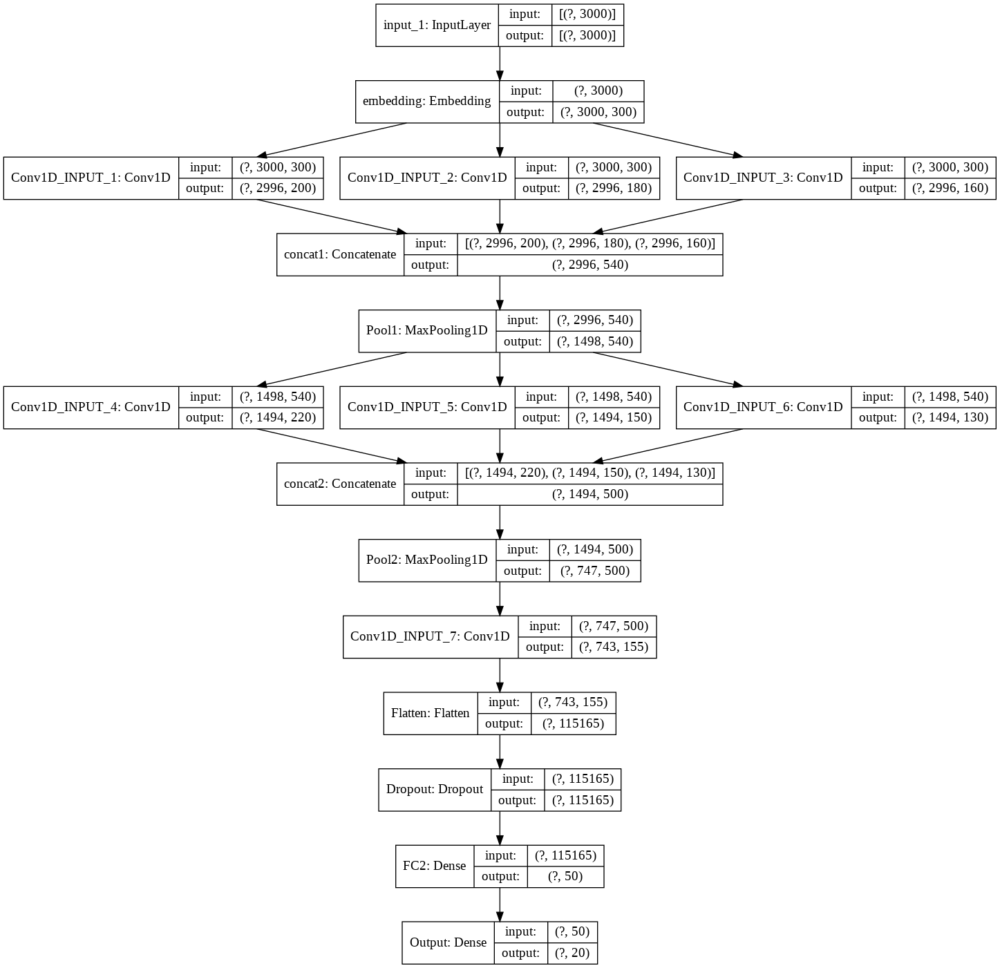

In [ ]:
dot_img_file = 'model_1.png'
tf.keras.utils.plot_model(model, to_file=dot_img_file, show_shapes=True)

### Model-2 : Using 1D convolutions with character embedding

<pre>
<pre><img src="https://i.ytimg.com/vi/CNY8VjJt-iQ/maxresdefault.jpg" width="70%">
Here are the some papers based on Char-CNN
 1. Xiang Zhang, Junbo Zhao, Yann LeCun. <a href="http://arxiv.org/abs/1509.01626">Character-level Convolutional Networks for Text Classification</a>.NIPS 2015
 2. Yoon Kim, Yacine Jernite, David Sontag, Alexander M. Rush. <a href="https://arxiv.org/abs/1508.06615">Character-Aware Neural Language Models</a>. AAAI 2016
 3. Shaojie Bai, J. Zico Kolter, Vladlen Koltun. <a href="https://arxiv.org/pdf/1803.01271.pdf">An Empirical Evaluation of Generic Convolutional and Recurrent Networks for Sequence Modeling</a>
 4. Use the pratrained char embeddings <a href='https://github.com/minimaxir/char-embeddings/blob/master/glove.840B.300d-char.txt'>https://github.com/minimaxir/char-embeddings/blob/master/glove.840B.300d-char.txt</a>
</pre>

<img src='https://i.imgur.com/EuuoJtr.png'>

In [ ]:
!wget --header="Host: doc-0k-3o-docs.googleusercontent.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/84.0.4147.135 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9" --header="Referer: https://drive.google.com/drive/u/0/my-drive" --header="Cookie: AUTH_gjojhqhi4lag2uhnc0pb2jeln2u870gk_nonce=3jo7acrtl2ltg" --header="Connection: keep-alive" "https://doc-0k-3o-docs.googleusercontent.com/docs/securesc/d201caojpdbt8uokhi08svtinkn1a9si/tupu9nlm21171kbh09vif6hjcsaqbfq6/1599750900000/13071881423479456781/13071881423479456781/1kWuXm3cJIr89x7e4NkHIJizzmPS5fztD?e=download&authuser=0&nonce=3jo7acrtl2ltg&user=13071881423479456781&hash=atjoni33t6hnjk9aqlfjjnkhha9c4vm9" -c -O 'file1.csv'

--2020-09-10 15:16:02--  https://doc-0k-3o-docs.googleusercontent.com/docs/securesc/d201caojpdbt8uokhi08svtinkn1a9si/tupu9nlm21171kbh09vif6hjcsaqbfq6/1599750900000/13071881423479456781/13071881423479456781/1kWuXm3cJIr89x7e4NkHIJizzmPS5fztD?e=download&authuser=0&nonce=3jo7acrtl2ltg&user=13071881423479456781&hash=atjoni33t6hnjk9aqlfjjnkhha9c4vm9
Resolving doc-0k-3o-docs.googleusercontent.com (doc-0k-3o-docs.googleusercontent.com)... 173.194.79.132, 2a00:1450:4013:c05::84
Connecting to doc-0k-3o-docs.googleusercontent.com (doc-0k-3o-docs.googleusercontent.com)|173.194.79.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘file1.csv’

file1.csv               [  <=>               ]  15.93M  43.8MB/s    in 0.4s    

2020-09-10 15:16:03 (43.8 MB/s) - ‘file1.csv’ saved [16703156]



In [82]:
import pandas as pd
df = pd.read_csv('/content/file1.csv')
df = df.drop(['Unnamed: 0'], axis=1)
df

,Prepocess_email,Prepocess_subject,Prepocess_text
0,altair csustan edu nps navy mil,acm siggraph registration problem,acm siggraph registration problem word warning...
1,irs inf tudresden irs inf tudresden,xdm backgroundpixmap,xdm background tried get rid xdm ugly window g...
2,pooh bears aurora engr latech edu engr latech ...,faith and dogma,article dogma dangerous dogma inevitable chris...
3,ramsey laurentian sfu ca fraser sfu cam org ra...,canadiens another stanley cup,canadiens another stanley cup kind team take c...
4,access digex com,is key escrow enough,key escrow enough points raised checking actua...
...,...,...,...
18823,monash edu,where did the hacker ethic go,hacker ethic cheerful note perhaps not complet...
18824,novell com oasun oracle com oracle com novell com,how to act in front of traffic jerks,act front traffic jerks article unless cager p...
18825,albnyvms bitnet,buying a used car,buying used car questions tax used car purchas...
18826,adobe com,honda accord brake problem,writes hit magic mile mark sorts things beginn...


In [83]:
import pandas as pd

df1 = pd.read_csv('/content/file2.csv')
df1 = df1.drop(['Unnamed: 0'], axis=1)
df1

,labels
0,comp.graphics
1,comp.windows.x
2,alt.atheism
3,rec.sport.hockey
4,sci.crypt
...,...
18823,comp.graphics
18824,rec.motorcycles
18825,rec.autos
18826,rec.autos


In [84]:
df=df.applymap(str)
df1=df1.applymap(str)

In [85]:
che= df

combine = che['Prepocess_email'] + " " + che["Prepocess_subject"] + " "+ che["Prepocess_text"]

In [86]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(combine, df1, test_size=0.25, stratify=df1)

In [87]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)


(14121,) (14121, 1)
(4707,) (4707, 1)


In [88]:
X_train

13524    cco caltech edu prism ccs uwo cco caltech edu ...
4363     cwru edu darkside osrhe uoknor edu okcforum os...
76       campaign org president is trip to pittsburg pr...
8575     fedex msfc nasa gov iti org iti org judy edu f...
17417    sunysb edu clio rad sunysb edu hidden markov m...
                               ...                        
916      spam maths adelaide edu access digex com acces...
10909    tegra com eskimo com eskimo com monitors nanao...
16869    icogsci ucsd edu ucsd edu always in scsi card ...
2524     ncratl atlantaga ncr com atlantaga ncr com jus...
6385     suite com mizzou missouri edu suite com certif...
Length: 14121, dtype: object

In [89]:
y_train

,labels
13524,sci.space
4363,alt.atheism
76,talk.politics.misc
8575,sci.space
17417,sci.crypt
...,...
916,sci.space
10909,comp.sys.ibm.pc.hardware
16869,comp.sys.ibm.pc.hardware
2524,talk.politics.misc


In [90]:
import tensorflow as tf

In [91]:
tf.keras.backend.clear_session()

In [92]:
t1 =tf.keras.preprocessing.text.Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\\]^`{|}~\t\n', lower=False,char_level=True)


# fit the tokenizer on the documents
t1.fit_on_texts(X_train)
#t.texts_to_sequences(s)

In [93]:
print(t1.word_counts)

OrderedDict([('c', 457734), ('o', 755618), (' ', 1787159), ('a', 786505), ('l', 552056), ('t', 797844), ('e', 1309509), ('h', 245688), ('d', 432570), ('u', 359564), ('p', 321408), ('r', 709590), ('i', 788642), ('s', 767135), ('m', 326706), ('w', 159458), ('n', 769933), ('j', 20624), ('g', 287120), ('v', 133404), ('k', 121366), ('b', 160874), ('f', 160779), ('x', 45232), ('y', 195646), ('q', 21022), ('z', 18460), ('_', 7351)])


In [94]:
len(t1.word_index)

28

In [95]:
import numpy

In [96]:
te = y_train['labels']

te = te.to_numpy()

te.reshape(-1,1)

array([['sci.space'],
       ['alt.atheism'],
       ['talk.politics.misc'],
       ...,
       ['comp.sys.ibm.pc.hardware'],
       ['talk.politics.misc'],
       ['sci.crypt']], dtype=object)

In [97]:
from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder()

y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

y_train_ohe = encoder.fit_transform(y_train.reshape(-1,1))
y_test_ohe = encoder.transform(y_test.reshape(-1,1))

y_train_ohe = y_train_ohe.toarray()
y_test_ohe = y_test_ohe.toarray()

In [98]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
import numpy as np

In [99]:
#max_length = 3000


docs = t1.texts_to_sequences(X_train)

padded_docs_train = pad_sequences(docs, padding='post')

In [100]:
padded_docs_train.shape

(14121, 44590)

In [101]:
docs = t1.texts_to_sequences(X_test)

padded_docs_test = pad_sequences(docs, padding='post')

In [102]:
padded_docs_test.shape

(4707, 31910)

##### As we can see dimention is not same  we have to pad in such a manner so that information should not lost i am taking padding arround average of features


In [103]:
max_length = 28000

docs = t1.texts_to_sequences(X_train)

padded_docs_train = pad_sequences(docs, maxlen=max_length, padding='post')

In [104]:
max_length = 28000

docs = t1.texts_to_sequences(X_test)

padded_docs_test = pad_sequences(docs, maxlen=max_length, padding='post')

In [105]:
padded_docs_train.shape

(14121, 28000)

In [106]:
padded_docs_test.shape

(4707, 28000)

In [ ]:
!wget --header="Host: codeload.github.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/84.0.4147.135 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9" --header="Referer: https://github.com/minimaxir/char-embeddings" --header="Cookie: _octo=GH1.1.957602068.1581314984; logged_in=no; _ga=GA1.2.1512213504.1581314992; tz=Asia%2FCalcutta; _gat=1" --header="Connection: keep-alive" "https://codeload.github.com/minimaxir/char-embeddings/zip/master" -c -O 'char-embeddings-master.zip'

--2020-09-10 10:55:01--  https://codeload.github.com/minimaxir/char-embeddings/zip/master
Resolving codeload.github.com (codeload.github.com)... 140.82.114.9
Connecting to codeload.github.com (codeload.github.com)|140.82.114.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘char-embeddings-master.zip’

char-embeddings-mas     [      <=>           ]  10.90M  5.66MB/s    in 1.9s    

2020-09-10 10:55:04 (5.66 MB/s) - ‘char-embeddings-master.zip’ saved [11431744]



In [ ]:
!unzip -q "/content/char-embeddings-master.zip"

In [107]:
embeddings_index = {}
f = open("/content/char-embeddings-master/glove.840B.300d-char.txt")
for line in f:
    values = line.split()
    #print(values)
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

print('Found %s word vectors.' % len(embeddings_index))

Found 94 word vectors.


In [108]:
embedding_matrix = np.zeros((len(t1.word_index) + 1, 300))
for word, i in t1.word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # words not found in embedding index will be all-zeros.
        embedding_matrix[i] = embedding_vector

In [109]:
embedding_matrix.shape

(29, 300)

In [110]:
!rm -rf ./logs1/ 

In [111]:
from tensorflow.keras.layers import Dense,Input,Conv1D,MaxPool2D,Activation,Dropout,Flatten,GlobalAveragePooling2D,Embedding,concatenate,MaxPool1D
from tensorflow.keras.models import Model ,Sequential

import random as rn

In [112]:
embedding_layer = Embedding(len(t1.word_index)+1,
                            300,
                            weights=[embedding_matrix],
                            input_length=28000,
                            trainable=False)

In [113]:
sequence_input = Input(shape=(28000,), dtype='int32')
embedded_sequences = embedding_layer(sequence_input)

x1 = Conv1D(128, 5, activation='relu',name = "Conv1D_INPUT_1")(embedded_sequences)

x2 = Conv1D(120, 5, activation='relu',name = "Conv1D_INPUT_2")(x1)

#x3 = Conv1D(125, 5, activation='relu',name = "Conv1D_INPUT_3")(embedded_sequences)

#concat1 = concatenate(inputs = [x1,x2,x3],name = "concat1")

pool1 = MaxPool1D(pool_size=2, strides=2, padding='valid', data_format='channels_last',name = "Pool1")(x2)



x4 = Conv1D(130, 5, activation='relu',name = "Conv1D_INPUT_4")(pool1)

x5 = Conv1D(135, 5, activation='relu',name = "Conv1D_INPUT_5")(x4)

#x6 = Conv1D(150, 5, activation='relu',name = "Conv1D_INPUT_6")(pool1)

#concat2 = concatenate(inputs = [x4,x5,x6],name = "concat2")


pool2 = MaxPool1D(pool_size=2, strides=2, padding='valid', data_format='channels_last',name = "Pool2")(x5)


#x7 = Conv1D(155, 5, activation='relu',name = "Conv1D_INPUT_7")(pool2)


flatten = Flatten(data_format='channels_last',name='Flatten')(pool2)

drop = Dropout(0.50,name='Dropout')(flatten)

dense = Dense(units=30,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=33),name='Dense')(drop)


Out = Dense(units=20,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=3),name='Output')(dense)




In [114]:
model1 = Model(inputs=sequence_input, outputs=Out)

In [115]:
model1.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 28000)]           0         
_________________________________________________________________
embedding (Embedding)        (None, 28000, 300)        8700      
_________________________________________________________________
Conv1D_INPUT_1 (Conv1D)      (None, 27996, 128)        192128    
_________________________________________________________________
Conv1D_INPUT_2 (Conv1D)      (None, 27992, 120)        76920     
_________________________________________________________________
Pool1 (MaxPooling1D)         (None, 13996, 120)        0         
_________________________________________________________________
Conv1D_INPUT_4 (Conv1D)      (None, 13992, 130)        78130     
_________________________________________________________________
Conv1D_INPUT_5 (Conv1D)      (None, 13988, 135)       

In [116]:
import numpy as np
from keras.callbacks import Callback
from sklearn.metrics import confusion_matrix, f1_score, precision_score, recall_score
from sklearn.metrics import roc_auc_score

class Metrics(Callback):
    
    def __init__(self,training_data,validation_data):
        
        self.x = training_data[0]
        self.y = training_data[1]
        self.x_val = validation_data[0]
        self.y_val = validation_data[1]

    
    def on_train_begin(self, logs={}):
        
        self.val_f1s = []
        #self.auc = []
        
    def on_epoch_end(self, epoch, logs={}):
        
        val_predict = (np.asarray(self.model.predict(self.x_val))).round()
        val_targ = self.y_val
        
        _val_f1 = f1_score(val_targ, val_predict,average='micro')
        #_val_roc_val = roc_auc_score(val_targ,val_predict)
        
        self.val_f1s.append(_val_f1)
        #self.auc.append(_val_roc_val)

        
        print(" — val_f1: %f" %(_val_f1))
        return

In [117]:
earlystop = tf.keras.callbacks.EarlyStopping(
    monitor='accuracy', min_delta=0, patience=0, verbose=0, mode='auto',
    baseline=None, restore_best_weights=False
)

In [118]:
metrics = Metrics(training_data=(padded_docs_train, y_train_ohe),validation_data=(padded_docs_test, y_test_ohe))

In [119]:
%load_ext tensorboard
import datetime

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [131]:
!rm -rf ./logs0/ 

In [120]:
log_dir="/content/logs0/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)

In [121]:
model1.compile(optimizer=tf.keras.optimizers.Adam(lr=0.0001),
              loss='categorical_crossentropy',metrics=['accuracy'])

model1.fit(padded_docs_train, y_train_ohe, validation_data=(padded_docs_test, y_test_ohe),
          epochs=4, batch_size=16,callbacks=[earlystop,tensorboard_callback,metrics])




Epoch 1/4
883/883 [==============================] - 474s 537ms/step - loss: 2.9803 - accuracy: 0.0730 - val_loss: 2.9728 - val_accuracy: 0.0784
Epoch 2/4
883/883 [==============================] - 477s 540ms/step - loss: 2.9617 - accuracy: 0.0775 - val_loss: 2.9701 - val_accuracy: 0.0710
Epoch 3/4
883/883 [==============================] - 477s 541ms/step - loss: 2.9273 - accuracy: 0.0903 - val_loss: 2.9555 - val_accuracy: 0.0788
Epoch 4/4
883/883 [==============================] - 478s 541ms/step - loss: 2.8559 - accuracy: 0.1144 - val_loss: 2.9585 - val_accuracy: 0.0865


In [130]:
%tensorboard --logdir /content/logs0

Reusing TensorBoard on port 6007 (pid 2331), started 0:07:52 ago. (Use '!kill 2331' to kill it.)

<IPython.core.display.Javascript object>

In [123]:
model1.save_weights('best_model_2.h5') 

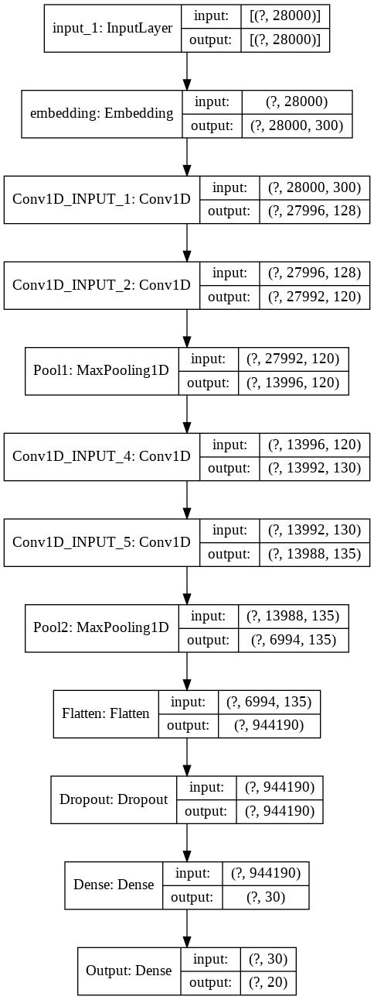

In [126]:
dot_img_file = 'model_2.png'
tf.keras.utils.plot_model(model1, to_file=dot_img_file, show_shapes=True)

In [129]:
tf.keras.backend.clear_session()